<a href="https://colab.research.google.com/github/vineetyadav/datasciencecoursera/blob/master/UW_Madison_GI_Tract_Image_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
! mkdir ~/.kaggle

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!pip uninstall -y kaggle
!pip install --upgrade pip
!pip install kaggle==1.5.6

Found existing installation: kaggle 1.5.12
Uninstalling kaggle-1.5.12:
  Successfully uninstalled kaggle-1.5.12
     |████████████████████████████████| 2.1 MB 4.1 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 21.1.3
    Uninstalling pip-21.1.3:
      Successfully uninstalled pip-21.1.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.2/58.2 KB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for kaggle: filename=kaggle-1.5.6-py3-none-any.whl size=72858 sha256=6b688fb7cb1847087bb707a5a8eb1ccc56de9656f4b1bb7e741b1d7e569ef25d
  Stored in directory: /root/.cache/pip/wheels/aa/e7/e7/eb3c3d514c33294d77ddd5a856bdd58dc9c1fabbed59a02a2b
Successfully built kaggle


In [2]:
!kaggle competitions download -c uw-madison-gi-tract-image-segmentation

uw-madison-gi-tract-image-segmentation.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
!unzip /content/uw-madison-gi-tract-image-segmentation.zip


Streaming output truncated to the last 5000 lines.
  inflating: train/case77/case77_day20/scans/slice_0121_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0122_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0123_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0124_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0125_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0126_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0127_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0128_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0129_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0130_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0131_266_266_1.50_1.50.png  
  inflating: train/case77/case77_day20/scans/slice_0132_266_266_1.50_

In [4]:
import pandas as pd
train_df= pd.read_csv("/content/train.csv")
train_df.head()

,id,class,segmentation
0,case123_day20_slice_0001,large_bowel,NaN
1,case123_day20_slice_0001,small_bowel,NaN
2,case123_day20_slice_0001,stomach,NaN
3,case123_day20_slice_0002,large_bowel,NaN
4,case123_day20_slice_0002,small_bowel,NaN


##Analyze empty Nan

In [3]:
print("Total no of rows with null values::", len(train_df.isna()))
#remove rows with null values 
train_df = train_df[train_df["segmentation"].notna()]
train_df.head()

Total no of rows with null values:: 115488


,id,class,segmentation
194,case123_day20_slice_0065,stomach,28094 3 28358 7 28623 9 28889 9 29155 9 29421 ...
197,case123_day20_slice_0066,stomach,27561 8 27825 11 28090 13 28355 14 28620 15 28...
200,case123_day20_slice_0067,stomach,15323 4 15587 8 15852 10 16117 11 16383 12 166...
203,case123_day20_slice_0068,stomach,14792 5 15056 9 15321 11 15587 11 15852 13 161...
206,case123_day20_slice_0069,stomach,14526 6 14789 12 15054 14 15319 16 15584 17 15...


###Analyze the image 

In [5]:
import re
import os
image_path_dict = {}
def analyze(image_list):
  case_days_regex = r".*(case\d+_day\d+).*slice_\d+.*.png"
  for each_image_path in image_list:
    m = re.search(case_days_regex,each_image_path)
    image_path_dict.setdefault(m.group(1),[])
    curr_image_list = image_path_dict[m.group(1)]
    curr_image_list.append(each_image_path)
  return image_path_dict





In [6]:
import glob2
folder_path = "/content/train/**/**/scans"
file_list = glob2.glob(folder_path+"/*.png")
image_map = analyze(file_list)
image_map.keys()

image_map["case33_day0"]
#print("Total no of images::",image_counter)

['/content/train/case33/case33_day0/scans/slice_0012_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0143_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0055_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0140_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0119_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0074_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0001_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0133_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0071_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0034_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0108_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0003_266_266_1.50_1.50.png',
 '/content/train/case33/case33_day0/scans/slice_0041_266_266_1.50_1.50.png',

In [45]:
!pip install natsort
import natsort
sorted_list = natsort.natsorted(image_map["case33_day0"])


In [10]:
%matplotlib inline
import matplotlib.pyplot as plt
import imageio
plt.style.use('classic')
def show_images(images, figsize=(400,200), columns = 2):
  fig,axes =plt.subplots(nrows=10,ncols=2,figsize=(200,200))
  axes = axes.flatten()
  fig.tight_layout()
  #fig.set_figwidth(200)
  #fig.set_figheight(200)

  for i in range(20):
    im = imageio.imread(images[i*10])
    axes[i].imshow(im,cmap="gray")
  plt.show()
show_images(sorted_list)

In [35]:
!pip install visvis
import numpy as np 
vol  = np.stack([imageio.imread(sorted_list[i*2]) for i in  range(100)])


In [38]:
# Select frame from "vol"
print(vol.shape)
im1 = vol[:, 50, :]
im2 = vol[:,:,50]

# Compute aspect ratios
#d0, d1, d2 = vol.meta["sampling"]
#asp1 = d0 / d2
#asp2 = d0/d1

# Plot the images on a subplots array 

fig, axes = plt.subplots(nrows=2, ncols=1,figsize=(200,200))
axes[0].imshow(im1, cmap='gray')
axes[1].imshow(im2,cmap="gray")
plt.show()

(100, 266, 266)


Data Type uint16
Minimum Intensity 0
Maximum Intensity 6018


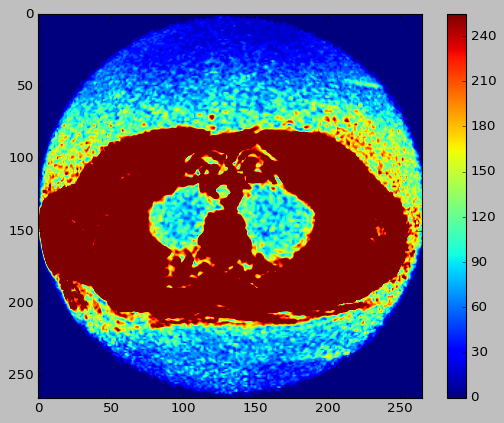

In [41]:
sample_image_1 = imageio.imread(sorted_list[10])
print("Data Type",sample_image_1.dtype)
print("Minimum Intensity",sample_image_1.min())
print("Maximum Intensity",sample_image_1.max())
# Plot the grayscale image
plt.imshow(sample_image_1,vmin=0,vmax=255)
plt.colorbar()


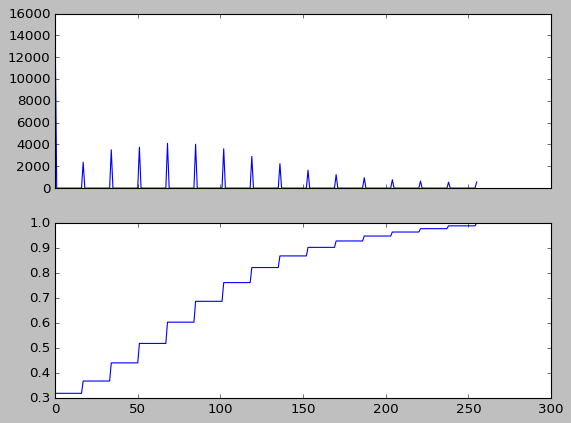

In [42]:
# Import SciPy's "ndimage" module
import scipy.ndimage as ndi

# Create a histogram, binned at each possible value
hist = ndi.measurements.histogram(sample_image_1, min=0, max=255, bins=256)

# Create a cumulative distribution function
cdf = hist.cumsum() / hist.sum()

# Plot the histogram and CDF
fig, axes = plt.subplots(2, 1, sharex=True)
axes[0].plot(hist, label='Histogram')
axes[1].plot(cdf, label='CDF')


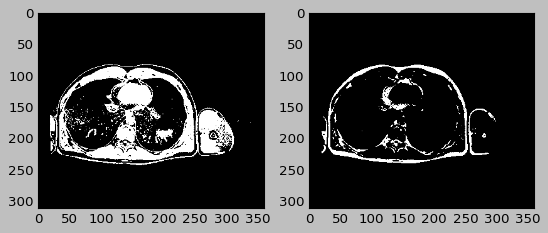

In [55]:
# Create skin and bone masks
sorted_list_1 = natsort.natsorted(image_map["case129_day27"])
sample_image_2 = imageio.imread(sorted_list_1[100])
mask_bone = sample_image_2 >= 145
mask_skin = (sample_image_2 >= 45) & (sample_image_2 < 145)

# Plot the skin (0) and bone (1) masks
fig, axes = plt.subplots(1,2)
axes[0].imshow(mask_skin, cmap='gray')
axes[1].imshow(mask_bone, cmap='gray')

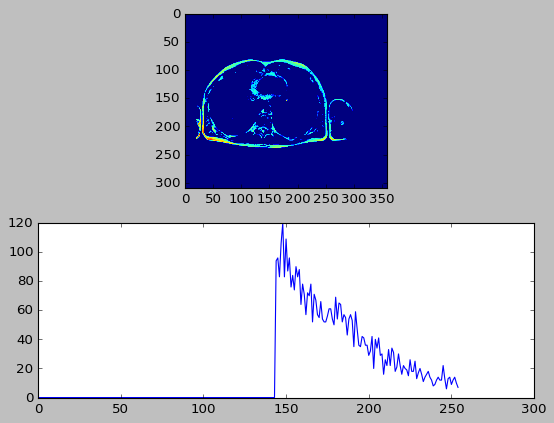

In [57]:
import scipy.ndimage as ndi

# Screen out non-bone pixels from "im"
mask_bone = sample_image_2 >= 145
im_bone = np.where(mask_bone, sample_image_2, 0)

# Get the histogram of bone intensities
hist = ndi.histogram(im_bone, min=1, max=255, bins=255)

# Plot masked image and histogram
fig, axes = plt.subplots(2,1)
axes[0].imshow(im_bone)
axes[1].plot(hist)

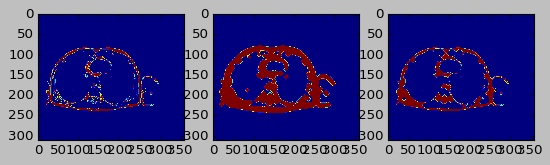

In [59]:
# Create and tune bone mask
mask_bone = sample_image_2 >= 145
mask_dilate = ndi.binary_dilation(mask_bone, iterations=5)
mask_closed = ndi.binary_closing(mask_bone, iterations=5)

# Plot masked images
fig, axes = plt.subplots(1,3)
axes[0].imshow(mask_bone)
axes[1].imshow(mask_dilate)
axes[2].imshow(mask_closed)